<a href="https://colab.research.google.com/github/seansothey/CSC685/blob/master/Project8_CNN_Face_Expression.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

![alt text](https://miro.medium.com/max/1200/1*Tdz9Pm3pTT75ix1yZDCSLg.png)

Facial expression recognition systems have attracted
much research interest within the field of artificial intelligence. Many established facial expression recognition
(FER) systems apply standard machine learning to extracted image features, and these methods generalize poorly
to previously unseen data. This project builds upon recent research to classify images of human faces into discrete emotion categories using convolutional neural networks (CNNs). We experimented with three different numbers of layers. Other methods such as max-pooling, fully connected dense layers, and data augmentation, were also used to increase accuracies for the six classes classification task.

**Image Datasets:**

There're 72 images of 6 people's face expression. Each person showed 6 different expression, such as 'anger', 'disgust', 'fear', 'happiness', 'neutrality' and 'sadness'. Each expression was captured 2 photos. Manually, choose training and testing set as following:


> Training set: 60 images

> Testing set: 12 images


Dataset link: https://faces.mpdl.mpg.de/imeji/collections?q=

**Machine Learning Techniques:** 


*   CNN 1, 3 and 5 layers
*   Max-Pooling
*   Data Augumentation

**Additionl Tools:**


*   Github & Kaggle: for hosting datasets and python notebook
*   Tableau: for report visualization









#Setup

In [1]:
# Common Import
import sklearn
import pandas as pd
import numpy as np
from sklearn import metrics
import seaborn as sns
import os
import time
import random

import tarfile
import cv2
from google.colab.patches import cv2_imshow

# to make this notebook's output stable across runs
np.random.seed(42)

from zipfile import ZipFile

from keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler,LabelEncoder

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

# Ignore useless warnings (see SciPy issue #5998)
import warnings
warnings.filterwarnings(action="ignore")

# sklearn version > 0.20 is required 
sklearn.__version__
# Update sklearn -> !pip install -U scikit-learn

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm
Using TensorFlow backend.


'0.22.2.post1'

#Custom Functions

This is a fucntion to download a file using **URL**. Then save it in the **save_path** with **target_file_name**. If target_file_name is empty, then the file name will be gotten from the URL.

In [0]:
import urllib
import urllib.parse as parse

def download(url,save_path,target_file_name=''):
  print("file is being downloading from {} ...".format(url))
  file = urllib.request.urlopen(url)
  fileData = file.read()

  if target_file_name=='':
    split=parse.urlsplit(url)
    target_file_name = split.path.split('/')[-1]
  
  if not os.path.exists(save_path):
    os.mkdir(save_path)

  targetFile = os.path.join(save_path,target_file_name)
  with open(targetFile,'wb') as f:
    f.write(fileData)
  print('Done, file in the path {}'.format(targetFile))

This is a function to extract tar file in the **tar_file_path**, which includes the file name and the extension, to **target_path**.

In [0]:
def extractTar(tar_file_path,target_path):
    print("Extracting is starting....")
    tar=tarfile.open(tar_file_path)
    tar.extractall(target_path)
    tar.close()
    print("Done")

This is a function to extract zip file in the **zip_file_path**, which includes the file name and the extension, to **target_path**.

In [0]:
def extractZip(zip_file_path,target_path):
    print("Extracting is starting....")
    zFile=ZipFile(zip_file_path)
    zFile.extractall(target_path)
    zFile.close()
    print("Done")

This is a custom function to create a imgs set without labels, unsupervised dataset. It used the folder path of the imgs.

In [0]:
def create_img_set(imgs_folder_path):
  x=[]
  lst = os.listdir(imgs_folder_path)
  for img in lst:
    img_imr = cv2.imread(os.path.join(imgs_folder_path,img))
    img_imr = cv2.resize(img_imr,(256,256))
    x.append(np.array(img_imr))
  return x

randomly_sho_imgs is for randomly display nrows x ncols images from the training set 

In [0]:
def randomly_show_imgs(x_set,nrows,ncols):
  #plt.figure(figsize=(10,10))
  for i in range(nrows*ncols):
    plt.subplot(nrows,ncols,i+1)
    indx = random.randint(0,len(x_set))
    plt.cv2.imshow(x_set[indx])
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
  plt.show()

## Preprocessing Data

In [0]:
root_path = 'data'
if not os.path.exists(root_path):
  os.mkdir(root_path)

In [8]:
download('https://storage.googleapis.com/kaggle-data-sets/633155/1126184/bundle/archive.zip?GoogleAccessId=web-data@kaggle-161607.iam.gserviceaccount.com&Expires=1588754502&Signature=S%2Fpoax1CqE1qKjjp4QTMD5e0UG4KuXlFJpnTJspH1m9FrrwT5EZSvgcGbyCVq9YmhslZOtBtdR3Zgq7ZTO51z1uu0WPfLOA3epbZtCTHaTxmXSmPv2zCa9cFHNMxqbSRsU9v1UxgZQnsojKrNfeId4nJTJpKjwCNLzj9LMNWVtnLTs%2Bb67pf7lSPYchUZOD%2Fowwa4KOun45ygI%2BJ1E52Dw2t8QRnEwckdU84%2Bod70CtfPLuF3GzPOpRiud2W%2FxfvOcf9skIsNvXfmlLYwPPjSy97kkJk0u6MCumT7rkeSnyZc9gZe9N%2BUYfkW6g2d9yePaVPGSfUh1fr0m4poxd8RA%3D%3D&response-content-disposition=attachment%3B+filename%3Dface-train.zip',os.path.join(root_path,'Faces'),'face_train.zip')

file is being downloading from https://storage.googleapis.com/kaggle-data-sets/633155/1126184/bundle/archive.zip?GoogleAccessId=web-data@kaggle-161607.iam.gserviceaccount.com&Expires=1588754502&Signature=S%2Fpoax1CqE1qKjjp4QTMD5e0UG4KuXlFJpnTJspH1m9FrrwT5EZSvgcGbyCVq9YmhslZOtBtdR3Zgq7ZTO51z1uu0WPfLOA3epbZtCTHaTxmXSmPv2zCa9cFHNMxqbSRsU9v1UxgZQnsojKrNfeId4nJTJpKjwCNLzj9LMNWVtnLTs%2Bb67pf7lSPYchUZOD%2Fowwa4KOun45ygI%2BJ1E52Dw2t8QRnEwckdU84%2Bod70CtfPLuF3GzPOpRiud2W%2FxfvOcf9skIsNvXfmlLYwPPjSy97kkJk0u6MCumT7rkeSnyZc9gZe9N%2BUYfkW6g2d9yePaVPGSfUh1fr0m4poxd8RA%3D%3D&response-content-disposition=attachment%3B+filename%3Dface-train.zip ...
Done, file in the path data/Faces/face_train.zip


In [9]:
extractZip('data/Faces/face_train.zip', 'data/train/imgs')

Extracting is starting....
Done


In [10]:
download('https://storage.googleapis.com/kaggle-data-sets/633156/1126185/bundle/archive.zip?GoogleAccessId=web-data@kaggle-161607.iam.gserviceaccount.com&Expires=1588754936&Signature=GSDi0WhvK%2BOqgy0CWBmYz4rNLtkT2a2GRmxZEt3NM%2BHSsj86c21Zx1hqcDxMu5xOtV%2FnvZIScdVCvk3fnpw2xJHdJGNsOOnI%2FVuCi5IvxqxqVeuvG8VU3NIHQi1ZviffSq5zIdTu0ozcDBR9sbLdBTKTifAC%2BtLSqGj3qpgKstjggSsLMCbAFBDUrhc5tJrlO2erkYlB2oQl1RXH8sVrWYFDXlnMimCERisNCf6HMuVqxEDwKTJ9%2FQzI4L9SI6CwYWoJpHCvADQv%2FpTOpb3IFqQrMgveYBjsSS9P%2FMQmjauFz7n425HMfj6EwnbvtSsDyrXhDTGdWCSFRZEQQfdBFw%3D%3D&response-content-disposition=attachment%3B+filename%3Dface-test.zip',os.path.join(root_path,'Faces'),'face_test.zip')

file is being downloading from https://storage.googleapis.com/kaggle-data-sets/633156/1126185/bundle/archive.zip?GoogleAccessId=web-data@kaggle-161607.iam.gserviceaccount.com&Expires=1588754936&Signature=GSDi0WhvK%2BOqgy0CWBmYz4rNLtkT2a2GRmxZEt3NM%2BHSsj86c21Zx1hqcDxMu5xOtV%2FnvZIScdVCvk3fnpw2xJHdJGNsOOnI%2FVuCi5IvxqxqVeuvG8VU3NIHQi1ZviffSq5zIdTu0ozcDBR9sbLdBTKTifAC%2BtLSqGj3qpgKstjggSsLMCbAFBDUrhc5tJrlO2erkYlB2oQl1RXH8sVrWYFDXlnMimCERisNCf6HMuVqxEDwKTJ9%2FQzI4L9SI6CwYWoJpHCvADQv%2FpTOpb3IFqQrMgveYBjsSS9P%2FMQmjauFz7n425HMfj6EwnbvtSsDyrXhDTGdWCSFRZEQQfdBFw%3D%3D&response-content-disposition=attachment%3B+filename%3Dface-test.zip ...
Done, file in the path data/Faces/face_test.zip


In [11]:
extractZip('data/Faces/face_test.zip', 'data/test/imgs')

Extracting is starting....
Done


In [0]:
face_train = os.listdir('data/train/imgs/Face_Train')

In [13]:
len(face_train)

60

In [0]:
face_test = os.listdir('data/test/imgs/Face_Test')

In [15]:
len(face_test)

12

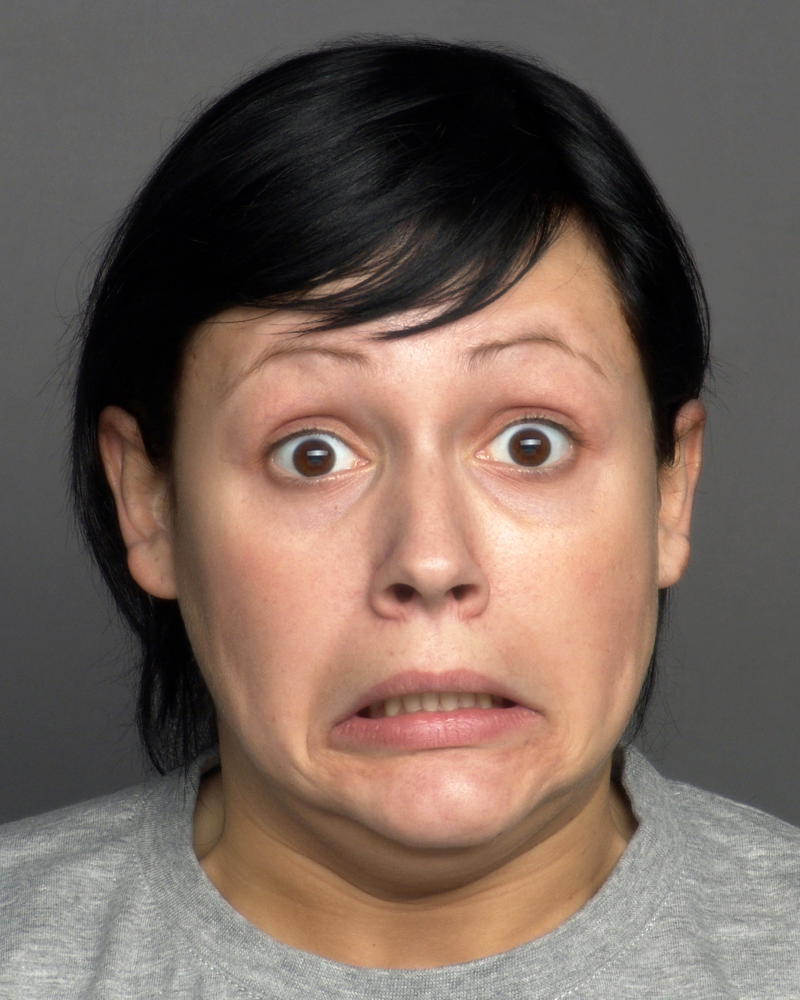

image size (3543, 2835, 3) 


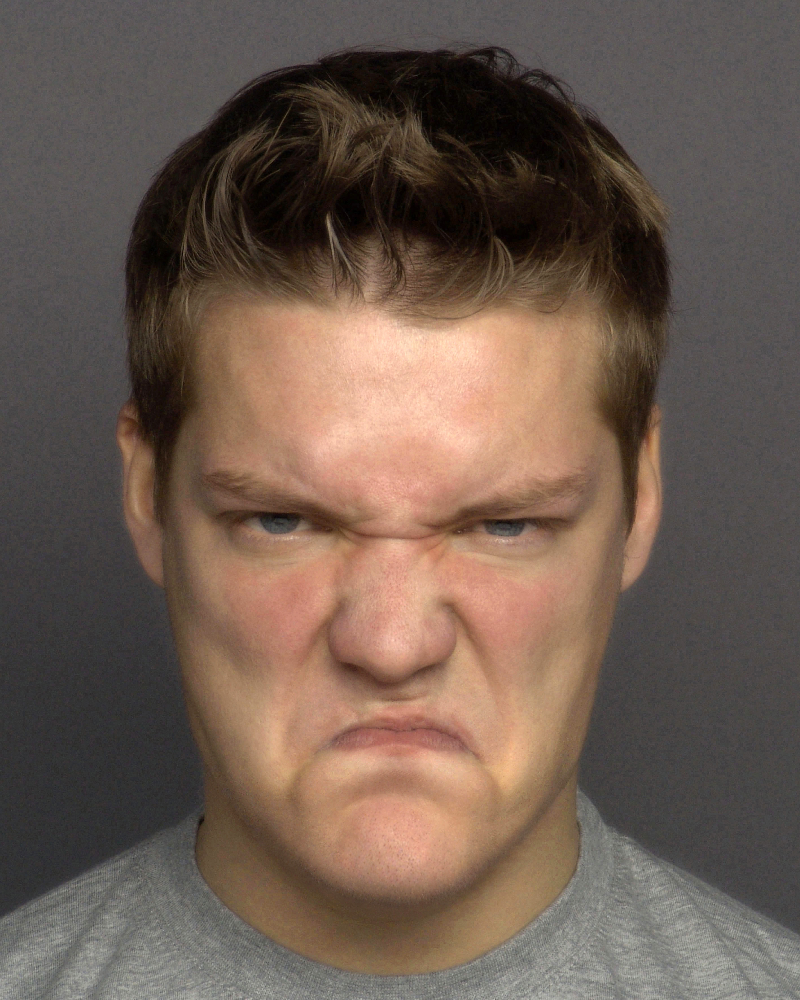

image size (3543, 2835, 3) 


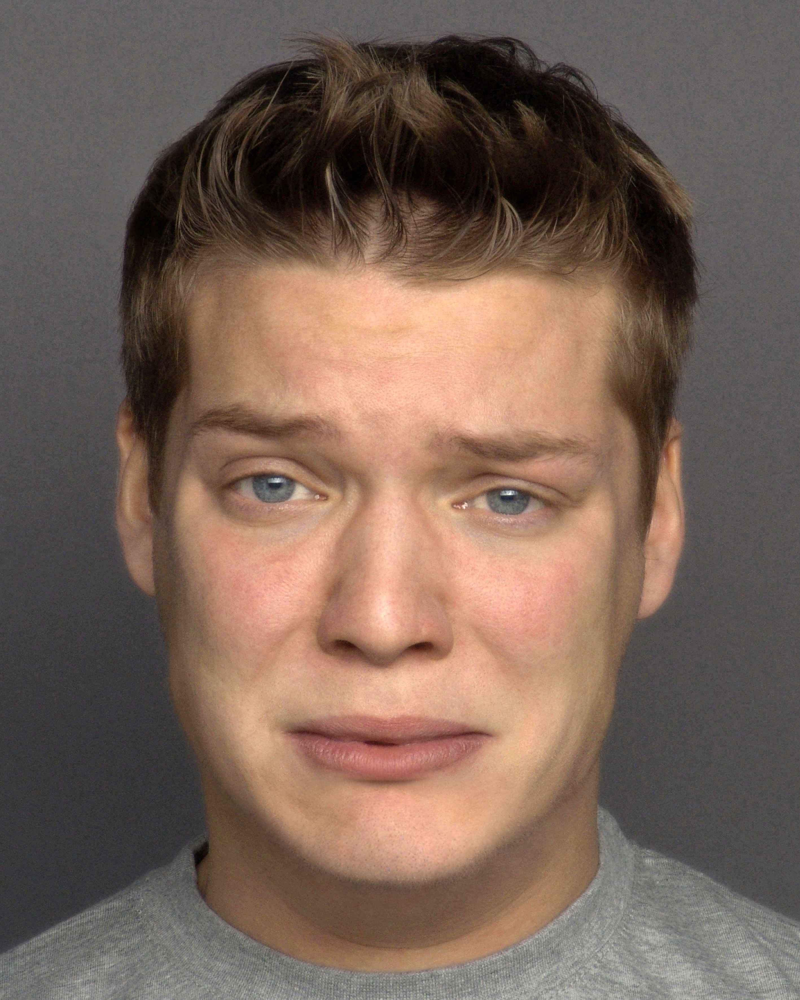

image size (3543, 2835, 3) 


In [16]:
# Plot to see some images of the dataset
for i in range(3):
  rndIndx = random.randint(0,len(face_train)-1)
  img = cv2.imread(os.path.join('data/train/imgs/Face_Train',face_train[rndIndx]))
  cv2_imshow(img)
  print('image size {} '.format(img.shape))


###Create the images dataset

In [0]:
X_train = create_img_set(os.path.join('data/train/imgs/Face_Train'))

In [0]:
X_test = create_img_set(os.path.join('data/test/imgs/Face_Test'))

Show some randomly images from the training set

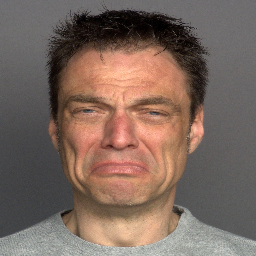

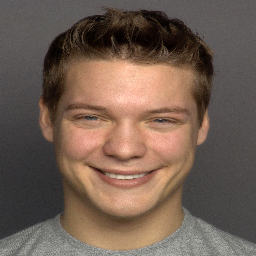

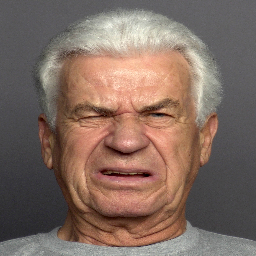

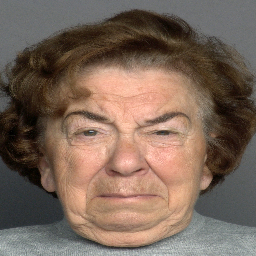

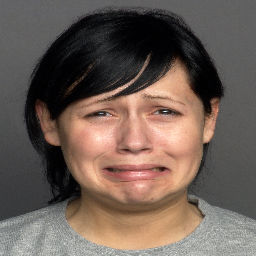

...

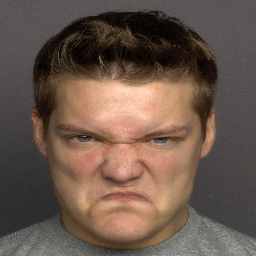

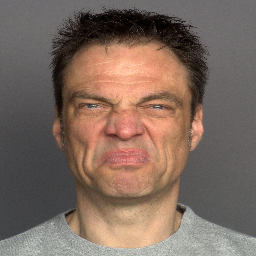

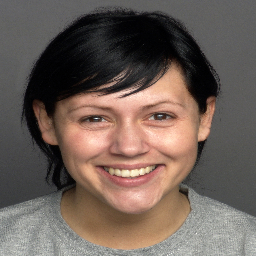

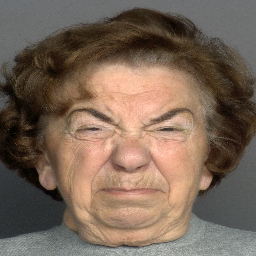

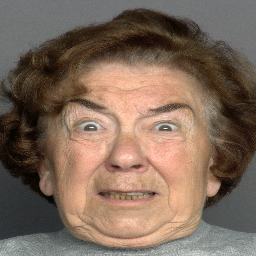

In [19]:
for i in range(0,12):
  cv2_imshow(X_train[i])

###Flattening the dataset

In [0]:
X_train = np.array(X_train)
X_test = np.array(X_test)

In [21]:
X_train.shape, X_test.shape

((60, 256, 256, 3), (12, 256, 256, 3))

###Create label y manually

In [0]:
label = ['anger','disgust','fear','happiness','neutrality','sadness']

In [0]:
#y_train = [[5],[3],[1],[5],[5],[3],[5],[0],[1],[3],
#           [1],[2],[3],[0],[1],[5],[4],[3],[4],[2],
#           [4],[0],[3],[0],[1],[3],[2],[0],[1],[5],
#           [2],[2],[3],[5],[4],[0],[4],[4],[5],[3],
#           [5],[2],[1],[4],[0],[1],[2],[4],[0],[2],
#           [5],[2],[4],[0],[4],[0],[5],[1],[2],[5]]

In [0]:
y_train = [5,3,1,5,5,3,5,0,1,3,
           1,2,3,0,1,5,4,3,4,2,
           4,0,3,0,1,3,2,0,1,5,
           2,2,3,5,4,0,4,4,5,3,
           5,2,1,4,0,1,2,4,0,2,
           5,2,4,0,4,0,5,1,2,5]

In [0]:
y_train = to_categorical(y_train,num_classes=len(label))

In [0]:
#y_test = [[5],[1],[3],[0],[2],[4],
#          [0],[4],[5],[2],[1],[3]]

In [0]:
y_actual = [5,1,3,0,2,4,0,4,5,2,1,3]

In [0]:
y_test = to_categorical(y_actual,num_classes=len(label))

##CNN 1-layer 

In [0]:
import keras
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D
from keras import regularizers

In [0]:
cnn1 = Sequential([
    Conv2D(32, kernel_size=(3, 3), activation='relu', strides=(4,4), kernel_regularizer=regularizers.l2(0.01), input_shape=(256,256,3)),
    MaxPooling2D(pool_size=(2, 2),strides=2),
    Flatten(),
    Dense(512, activation='relu'),
    Dense(64, activation='relu'),
    Dense(6, activation='softmax')
])

In [0]:
cnn1.compile(loss=keras.losses.categorical_crossentropy,
              optimizer=keras.optimizers.Adam(),
              metrics=['accuracy'])

In [32]:
cnn1.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 64, 64, 32)        896       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 32, 32, 32)        0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 32768)             0         
_________________________________________________________________
dense_1 (Dense)              (None, 512)               16777728  
_________________________________________________________________
dense_2 (Dense)              (None, 64)                32832     
_________________________________________________________________
dense_3 (Dense)              (None, 6)                 390       
Total params: 16,811,846
Trainable params: 16,811,846
Non-trainable params: 0
__________________________________________

###Training the model

In [33]:
tr1 = cnn1.fit(X_train, y_train,
          batch_size=3,
          epochs=20,
          verbose=1,
          validation_data=(X_train[:20], y_train[:20]))

Train on 60 samples, validate on 20 samples
Epoch 1/20
60/60 [==============================] - 1s 21ms/step - loss: 1273.1954 - accuracy: 0.1500 - val_loss: 195.7532 - val_accuracy: 0.2500
Epoch 2/20
60/60 [==============================] - 1s 14ms/step - loss: 69.6256 - accuracy: 0.2667 - val_loss: 33.0553 - val_accuracy: 0.1000
Epoch 3/20
60/60 [==============================] - 1s 14ms/step - loss: 18.2615 - accuracy: 0.2000 - val_loss: 15.5806 - val_accuracy: 0.2500
Epoch 4/20
60/60 [==============================] - 1s 14ms/step - loss: 9.9344 - accuracy: 0.2667 - val_loss: 9.6484 - val_accuracy: 0.3000
Epoch 5/20
60/60 [==============================] - 1s 14ms/step - loss: 4.1674 - accuracy: 0.5333 - val_loss: 3.9167 - val_accuracy: 0.4500
Epoch 6/20
60/60 [==============================] - 1s 15ms/step - loss: 2.2218 - accuracy: 0.6833 - val_loss: 0.4537 - val_accuracy: 0.9000
Epoch 7/20
60/60 [==============================] - 1s 14ms/step - loss: 1.1422 - accuracy: 0.7167 - 

###See the accuracy

In [34]:
score1 = cnn1.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score1[0])
print('Test accuracy:', score1[1])

Test loss: 3.763899087905884
Test accuracy: 0.25


It's very low, let's try some more layers and augument dataset.

###See the prediction

In [0]:
pred1 = cnn1.predict_classes(X_test, verbose=0)

In [36]:
pred1

array([3, 0, 3, 5, 0, 3, 0, 3, 3, 0, 3, 3])

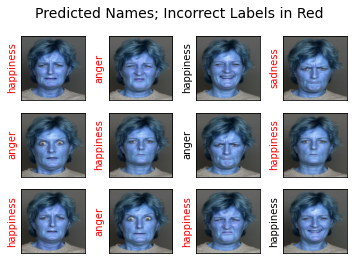

In [37]:
fig, ax = plt.subplots(3, 4)
for i, axi in enumerate(ax.flat):
    axi.imshow(X_test[i], cmap='bone')
    axi.set(xticks=[], yticks=[])
    axi.set_ylabel(label[pred1[i]].split()[-1],
                   color='black' if pred1[i] == y_actual[i] else 'red')
fig.suptitle('Predicted Names; Incorrect Labels in Red', size=14);

###Plot the learning curve

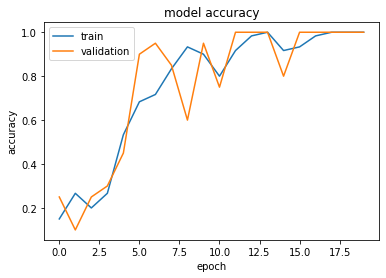

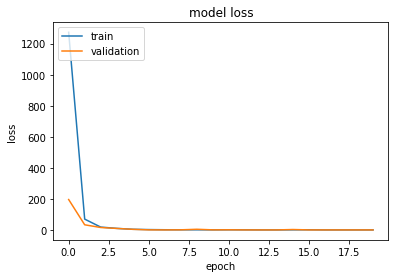

In [38]:
plt.plot(tr1.history['accuracy'])
plt.plot(tr1.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# summarize history for loss
plt.plot(tr1.history['loss'])
plt.plot(tr1.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

###Classification Report

In [39]:
from sklearn.metrics import classification_report
#target_names = ["Class {}".format(i) for i in range(6)]
print(classification_report(y_actual, pred1, target_names=label))

              precision    recall  f1-score   support

       anger       0.25      0.50      0.33         2
     disgust       0.00      0.00      0.00         2
        fear       0.00      0.00      0.00         2
   happiness       0.29      1.00      0.44         2
  neutrality       0.00      0.00      0.00         2
     sadness       0.00      0.00      0.00         2

    accuracy                           0.25        12
   macro avg       0.09      0.25      0.13        12
weighted avg       0.09      0.25      0.13        12



###Data Augumentation

In [0]:
from keras.preprocessing.image import ImageDataGenerator
gen = ImageDataGenerator(rotation_range=16, width_shift_range=0.2, shear_range=0.2, height_shift_range=0.2, zoom_range=0.2, 
                         featurewise_center=True, horizontal_flip=True, featurewise_std_normalization=True)
batches = gen.flow(X_train, y_train, batch_size=6)
val_batches = gen.flow(X_train[:20], y_train[:20], batch_size=5)

###Train model with augumented data

In [41]:
tr1_aug = cnn1.fit_generator(batches, steps_per_epoch=60//3, epochs=20,
                    validation_data=val_batches, validation_steps=20//5, use_multiprocessing=True)

Epoch 1/20
20/20 [==============================] - 3s 162ms/step - loss: 7.8285 - accuracy: 0.2333 - val_loss: 2.6278 - val_accuracy: 0.2500
Epoch 2/20
20/20 [==============================] - 3s 147ms/step - loss: 6.4726 - accuracy: 0.1167 - val_loss: 4.6747 - val_accuracy: 0.1000
Epoch 3/20
20/20 [==============================] - 3s 152ms/step - loss: 3.4933 - accuracy: 0.1750 - val_loss: 1.4502 - val_accuracy: 0.2500
Epoch 4/20
20/20 [==============================] - 3s 145ms/step - loss: 2.7057 - accuracy: 0.1417 - val_loss: 1.6709 - val_accuracy: 0.3000
Epoch 5/20
20/20 [==============================] - 3s 157ms/step - loss: 2.0377 - accuracy: 0.1583 - val_loss: 1.8467 - val_accuracy: 0.3500
Epoch 6/20
20/20 [==============================] - 3s 135ms/step - loss: 2.1295 - accuracy: 0.1667 - val_loss: 1.6840 - val_accuracy: 0.2500
Epoch 7/20
20/20 [==============================] - 3s 141ms/step - loss: 2.0810 - accuracy: 0.1833 - val_loss: 1.7188 - val_accuracy: 0.2000
Epoch 

See the accuracy after augumentation

In [42]:
score1_aug = cnn1.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score1_aug[0])
print('Test accuracy:', score1_aug[1])

Test loss: 1.9124836921691895
Test accuracy: 0.0833333358168602


##CNN 3-layers 

In [0]:
cnn3 = Sequential([
    Conv2D(32, kernel_size=(3, 3), activation='relu', strides=(4,4), kernel_regularizer=regularizers.l2(0.01), input_shape=(256,256,3)),  # 1st layer
    MaxPooling2D(pool_size=(2, 2),strides=2),

    Conv2D(32, kernel_size=(3,3), activation='relu', strides=(2,2), kernel_regularizer=regularizers.l2(0.01)), # 2nd layer
    MaxPooling2D(pool_size=(2,2), strides=2),

    Conv2D(64, kernel_size=(3,3), activation='relu', kernel_regularizer=regularizers.l2(0.01)), # 3rd layer
    MaxPooling2D(pool_size=(2,2), strides=2),

    Flatten(),
    Dense(512, activation='relu'),
    Dense(128, activation='relu'),
    Dense(32, activation='relu'),
    Dense(6, activation='softmax')
])

In [0]:
cnn3.compile(loss=keras.losses.categorical_crossentropy,
              optimizer=keras.optimizers.Adam(),
              metrics=['accuracy'])

In [45]:
cnn3.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_2 (Conv2D)            (None, 64, 64, 32)        896       
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 32, 32, 32)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 15, 15, 32)        9248      
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 7, 7, 32)          0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 5, 5, 64)          18496     
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 2, 2, 64)          0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 256)              

###Training the model

In [46]:
tr3 = cnn3.fit(X_train, y_train,
          batch_size=3,
          epochs=20,
          verbose=1,
          validation_data=(X_train[:20], y_train[:20]))

Train on 60 samples, validate on 20 samples
Epoch 1/20
60/60 [==============================] - 0s 6ms/step - loss: 7.0140 - accuracy: 0.1500 - val_loss: 3.4559 - val_accuracy: 0.2000
Epoch 2/20
60/60 [==============================] - 0s 3ms/step - loss: 2.8354 - accuracy: 0.2167 - val_loss: 2.8586 - val_accuracy: 0.1000
Epoch 3/20
60/60 [==============================] - 0s 3ms/step - loss: 2.5319 - accuracy: 0.1500 - val_loss: 2.3258 - val_accuracy: 0.1500
Epoch 4/20
60/60 [==============================] - 0s 3ms/step - loss: 2.4295 - accuracy: 0.1500 - val_loss: 2.2997 - val_accuracy: 0.3000
Epoch 5/20
60/60 [==============================] - 0s 3ms/step - loss: 2.3694 - accuracy: 0.1833 - val_loss: 2.2585 - val_accuracy: 0.2000
Epoch 6/20
60/60 [==============================] - 0s 3ms/step - loss: 2.2526 - accuracy: 0.2333 - val_loss: 2.1807 - val_accuracy: 0.4000
Epoch 7/20
60/60 [==============================] - 0s 3ms/step - loss: 2.1548 - accuracy: 0.4167 - val_loss: 1.9915

###See the accuracy

In [47]:
score3 = cnn3.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score3[0])
print('Test accuracy:', score3[1])

Test loss: 2.724411964416504
Test accuracy: 0.3333333432674408


###See the prediction

In [0]:
pred3 = cnn3.predict_classes(X_test, verbose=0)

In [49]:
pred3

array([2, 4, 2, 4, 2, 4, 0, 4, 2, 4, 2, 4])

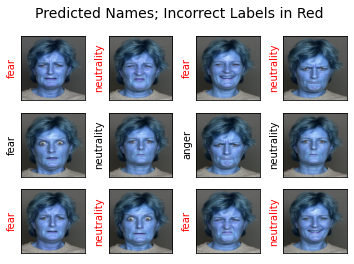

In [50]:
fig, ax = plt.subplots(3, 4)
for i, axi in enumerate(ax.flat):
    axi.imshow(X_test[i], cmap='bone')
    axi.set(xticks=[], yticks=[])
    axi.set_ylabel(label[pred3[i]].split()[-1],
                   color='black' if pred3[i] == y_actual[i] else 'red')
fig.suptitle('Predicted Names; Incorrect Labels in Red', size=14);

###Plot the learning curve

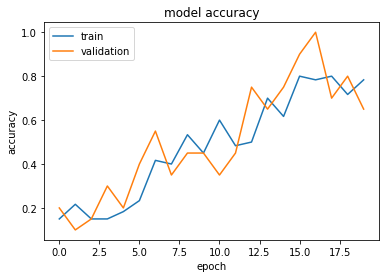

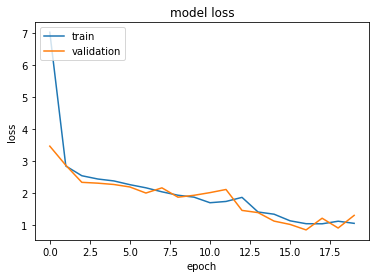

In [51]:
plt.plot(tr3.history['accuracy'])
plt.plot(tr3.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# summarize history for loss
plt.plot(tr3.history['loss'])
plt.plot(tr3.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

###Classification Report

In [52]:
from sklearn.metrics import classification_report
#target_names = ["Class {}".format(i) for i in range(6)]
print(classification_report(y_actual, pred3, target_names=label))

              precision    recall  f1-score   support

       anger       1.00      0.50      0.67         2
     disgust       0.00      0.00      0.00         2
        fear       0.20      0.50      0.29         2
   happiness       0.00      0.00      0.00         2
  neutrality       0.33      1.00      0.50         2
     sadness       0.00      0.00      0.00         2

    accuracy                           0.33        12
   macro avg       0.26      0.33      0.24        12
weighted avg       0.26      0.33      0.24        12



###Train model with augumented data

In [53]:
tr3_aug = cnn3.fit_generator(batches, steps_per_epoch=60//3, epochs=20,
                    validation_data=val_batches, validation_steps=20//5, use_multiprocessing=True)

Epoch 1/20
20/20 [==============================] - 2s 101ms/step - loss: 3.0327 - accuracy: 0.1583 - val_loss: 2.7779 - val_accuracy: 0.0500
Epoch 2/20
20/20 [==============================] - 2s 104ms/step - loss: 2.3594 - accuracy: 0.1583 - val_loss: 2.1747 - val_accuracy: 0.3500
Epoch 3/20
20/20 [==============================] - 2s 95ms/step - loss: 2.2564 - accuracy: 0.2083 - val_loss: 2.1859 - val_accuracy: 0.1500
Epoch 4/20
20/20 [==============================] - 2s 103ms/step - loss: 2.2893 - accuracy: 0.1667 - val_loss: 2.2200 - val_accuracy: 0.1000
Epoch 5/20
20/20 [==============================] - 2s 102ms/step - loss: 2.2517 - accuracy: 0.1917 - val_loss: 2.1497 - val_accuracy: 0.2500
Epoch 6/20
20/20 [==============================] - 2s 102ms/step - loss: 2.2550 - accuracy: 0.1667 - val_loss: 2.2793 - val_accuracy: 0.1000
Epoch 7/20
20/20 [==============================] - 2s 102ms/step - loss: 2.2157 - accuracy: 0.2750 - val_loss: 2.2808 - val_accuracy: 0.1000
Epoch 8

See the accuracy after augumentation

In [54]:
score3_aug = cnn3.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score3_aug[0])
print('Test accuracy:', score3_aug[1])

Test loss: 2.119351625442505
Test accuracy: 0.25


##CNN 5-layers 

In [0]:
cnn5 = Sequential([
    Conv2D(32, kernel_size=(3, 3), activation='relu', strides=(2,2), input_shape=(256,256,3)),  # 1st layer
    MaxPooling2D(pool_size=(2, 2),strides=2),

    Conv2D(32, kernel_size=(3,3), activation='relu'), # 2nd layer
    MaxPooling2D(pool_size=(2,2), strides=2),

    Conv2D(32, kernel_size=(3,3), activation='relu',  kernel_regularizer=regularizers.l2(0.01)), # 3rd layer
    MaxPooling2D(pool_size=(2,2), strides=2),

    Conv2D(64, kernel_size=(3,3), activation='relu'), # 4th layer
    MaxPooling2D(pool_size=(2,2), strides=2),

    Conv2D(64, kernel_size=(3,3), activation='relu', kernel_regularizer=regularizers.l2(0.01)), # 5th layer
    MaxPooling2D(pool_size=(2,2), strides=2),

    Flatten(),
    Dense(512, activation='relu'),
    Dense(128, activation='relu'),
    Dense(32, activation='relu'),
    Dense(6, activation='softmax')
])

In [0]:
cnn5.compile(loss=keras.losses.categorical_crossentropy,
              optimizer=keras.optimizers.Adam(),
              metrics=['accuracy'])

In [57]:
cnn5.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_5 (Conv2D)            (None, 127, 127, 32)      896       
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 63, 63, 32)        0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 61, 61, 32)        9248      
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 30, 30, 32)        0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 28, 28, 32)        9248      
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 12, 12, 64)       

###Training the model

In [58]:
tr5 = cnn5.fit(X_train, y_train,
          batch_size=3,
          epochs=20,
          verbose=1,
          validation_data=(X_train[:20], y_train[:20]))

Train on 60 samples, validate on 20 samples
Epoch 1/20
60/60 [==============================] - 1s 13ms/step - loss: 4.1587 - accuracy: 0.1333 - val_loss: 2.6464 - val_accuracy: 0.1000
Epoch 2/20
60/60 [==============================] - 1s 8ms/step - loss: 2.5919 - accuracy: 0.1500 - val_loss: 2.4980 - val_accuracy: 0.1000
Epoch 3/20
60/60 [==============================] - 1s 8ms/step - loss: 2.4313 - accuracy: 0.1667 - val_loss: 2.4081 - val_accuracy: 0.1000
Epoch 4/20
60/60 [==============================] - 1s 8ms/step - loss: 2.3704 - accuracy: 0.2500 - val_loss: 2.3419 - val_accuracy: 0.1500
Epoch 5/20
60/60 [==============================] - 1s 8ms/step - loss: 2.2940 - accuracy: 0.2500 - val_loss: 2.2807 - val_accuracy: 0.2000
Epoch 6/20
60/60 [==============================] - 1s 8ms/step - loss: 2.3082 - accuracy: 0.1667 - val_loss: 2.2341 - val_accuracy: 0.2000
Epoch 7/20
60/60 [==============================] - 1s 8ms/step - loss: 2.2291 - accuracy: 0.2333 - val_loss: 2.207

###See the accuracy

In [59]:
score5 = cnn5.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score5[0])
print('Test accuracy:', score5[1])

Test loss: 1.5758450031280518
Test accuracy: 0.5833333134651184


###See the prediction

In [0]:
pred5 = cnn5.predict_classes(X_test)

In [61]:
pred5

array([5, 5, 3, 0, 2, 2, 0, 2, 4, 2, 0, 3])

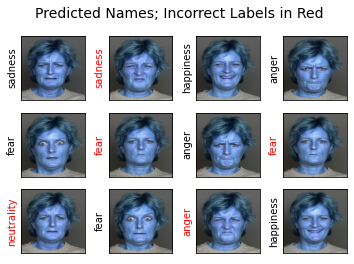

In [62]:
fig, ax = plt.subplots(3, 4)
for i, axi in enumerate(ax.flat):
    axi.imshow(X_test[i], cmap='bone')
    axi.set(xticks=[], yticks=[])
    axi.set_ylabel(label[pred5[i]].split()[-1],
                   color='black' if pred5[i] == y_actual[i] else 'red')
fig.suptitle('Predicted Names; Incorrect Labels in Red', size=14);

###Plot the learning curve

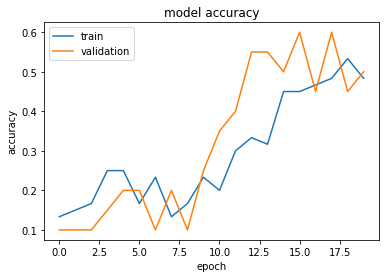

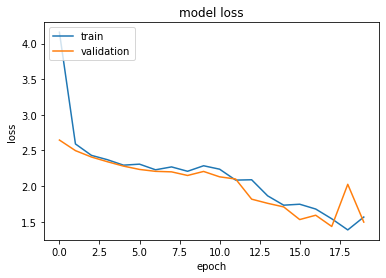

In [63]:
plt.plot(tr5.history['accuracy'])
plt.plot(tr5.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# summarize history for loss
plt.plot(tr5.history['loss'])
plt.plot(tr5.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

###Classification Report

In [64]:
from sklearn.metrics import classification_report
#target_names = ["Class {}".format(i) for i in range(6)]
print(classification_report(y_actual, pred5, target_names=label))

              precision    recall  f1-score   support

       anger       0.67      1.00      0.80         2
     disgust       0.00      0.00      0.00         2
        fear       0.50      1.00      0.67         2
   happiness       1.00      1.00      1.00         2
  neutrality       0.00      0.00      0.00         2
     sadness       0.50      0.50      0.50         2

    accuracy                           0.58        12
   macro avg       0.44      0.58      0.49        12
weighted avg       0.44      0.58      0.49        12



###Train model with augumented data

In [65]:
tr5_aug = cnn5.fit_generator(batches, steps_per_epoch=60//3, epochs=20,
                    validation_data=val_batches, validation_steps=20//5, use_multiprocessing=True)

Epoch 1/20
20/20 [==============================] - 2s 119ms/step - loss: 2.3659 - accuracy: 0.1833 - val_loss: 2.1361 - val_accuracy: 0.2500
Epoch 2/20
Epoch 1/20
20/20 [==============================] - 2s 113ms/step - loss: 2.1057 - accuracy: 0.3083 - val_loss: 1.9792 - val_accuracy: 0.2000
Epoch 3/20
20/20 [==============================] - 2s 102ms/step - loss: 2.1284 - accuracy: 0.2417 - val_loss: 1.9098 - val_accuracy: 0.1000
Epoch 4/20
20/20 [==============================] - 2s 119ms/step - loss: 2.0176 - accuracy: 0.3333 - val_loss: 1.7652 - val_accuracy: 0.3000
Epoch 5/20
20/20 [==============================] - 2s 108ms/step - loss: 2.0044 - accuracy: 0.3083 - val_loss: 1.8585 - val_accuracy: 0.4000
Epoch 6/20
20/20 [==============================] - 2s 104ms/step - loss: 1.9867 - accuracy: 0.3417 - val_loss: 1.7144 - val_accuracy: 0.5500
Epoch 7/20
20/20 [==============================] - 2s 122ms/step - loss: 1.9450 - accuracy: 0.3750 - val_loss: 2.0389 - val_accuracy: 0.

See the accuracy after augumentation

In [66]:
score5_aug = cnn5.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score5_aug[0])
print('Test accuracy:', score5_aug[1])

Test loss: 1.8728861808776855
Test accuracy: 0.4166666567325592


#Conclusion

*   50% majority of works and time were spent on data preprocessing, including upload, download, extracting, cleaning images and manually chose test set and created labels because the dataset has no labels. And the rest 50% was spent on choosing and testing hyper paramenters to build the learning models.
*   Number or layers and epochs play an important roles to determine the performance accuracy; however, the trade off is computation time which is very slow as expected. For sake of expriment time, each hyper parameter were chose abitrary without using hyper parameters tuning techniqe. Playing around with those parameters would give you more intuition of its effectiveness. 
*   Because the dataset is too small, the performance's error tends to be high even given more number of layers and epochs. Data augumentation was used to generate extra dataset; unfortuantely, it was not helpful at all for this small dataset if we take a look at the accuraccies.

*   Overall, the most challenging of building Convlutional Neural Network(CNN) model is to set up all those many complex mathematics hyper parameters. In order to build an efficient CNN model, data scientists or mahcine learning engineers must understand each parameter well and pick the right one complys to the dataset and its application. Likewise, in this face expression image classification experiment, CNN with five layers tends to give a better performance than the one and three layers. Once again, with the small dataset like this, we should already know ahead that the learning's performance will not do well. To improve this learning performance, getting more data is considered as a must.


*   Below is the summary barchart of the accuracies for CNN model data before and after augumentation, and with three different layers. 

![alt text](https://github.com/seansothey/CSC685/blob/master/CNN_Report.PNG?raw=true)


#Refrences

https://faces.mpdl.mpg.de/imeji/collections?q=

https://sju.instructure.com/courses/20477/assignments/194374

https://www.kaggle.com/tobikaggle/keras-mnist-cnn-learning-curve

https://nbviewer.jupyter.org/github/ageron/handson-ml2/blob/master/14_deep_computer_vision_with_cnns.ipynb